In [2]:
import sys, os
sys.path.append('..')
import matplotlib.pyplot as plt
from src.drone_em_dl import *

In [3]:
data = data.Data()
data.load_data('../data/raw/falster_data_Kristian.csv')
data.get_features([11,12,13,22,23,24,25,26,27,28,29,30,31]) #[1,2,3,4,5,6,7,8,9,10,11,12,13,14]  #[1,2,3,4,5,6,7,11,12,13,14,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31]
data.train_test_split(split=0.8)
data.norm_data()

PCA

In [4]:
pcas = Pca()
pcas.load_data(data.norm_data.norm_train,data.norm_data.norm_test)
pcas.get_pca(pca_amount=8)
train_pcs = data.get_inv(pcas.pca_train_inv)
train_org = data.get_inv(data.norm_data.norm_train)

AE

In [5]:
model = tf.keras.models.load_model('../models/AE_falter_06_04_2023_15_1/best_model_AE_falter_06_04_2023_15_1.h5', custom_objects={'lr': get_lr_metric})

2023-04-07 13:12:43.341151: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-04-07 13:12:43.341280: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Metal device set to: Apple M1 Max

systemMemory: 64.00 GB
maxCacheSize: 24.00 GB



In [6]:
results = Reconstruction()
results.load_model(model)
results.get_reconstructions(data.norm_data.norm_train)

recionstructed_data = data.get_inv(results.reconstructions)
input_data  = data.get_inv(data.norm_data.norm_train)
latent_space = results.latent_space

2023-04-07 13:13:40.390751: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-04-07 13:13:40.484208: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-04-07 13:13:53.204774: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


# Train

In [8]:
train_pcs.shape

(44922, 13)

In [10]:
data.test.columns.shape

(13,)

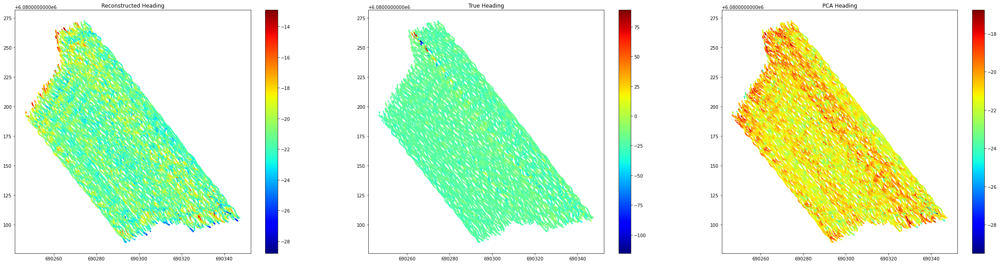

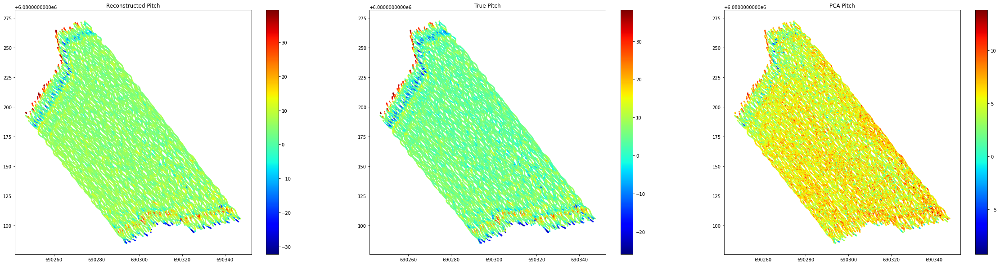

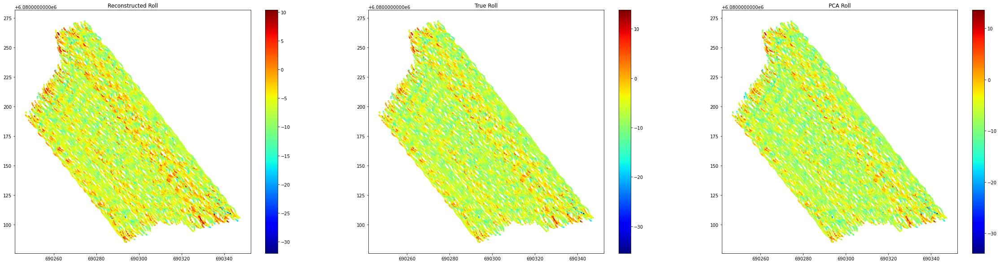

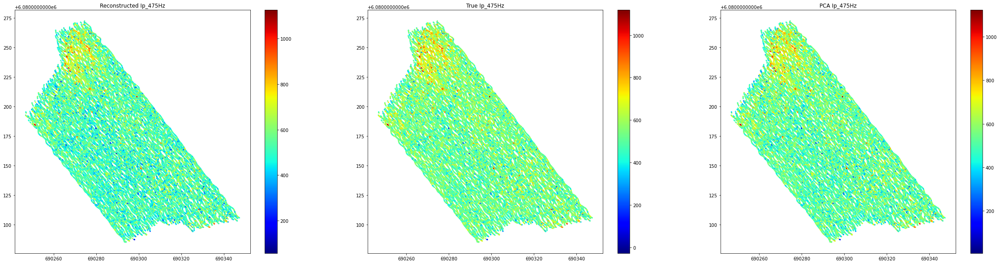

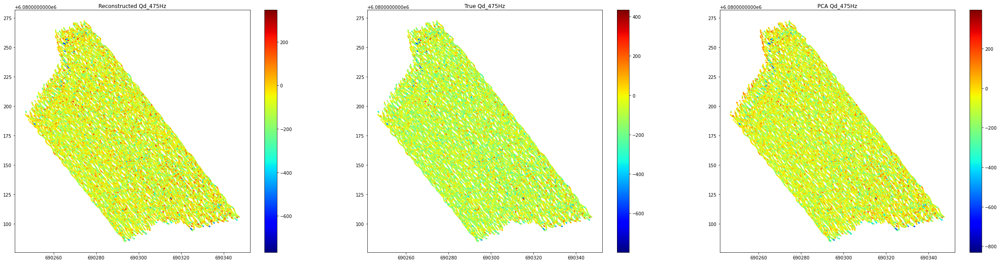

...

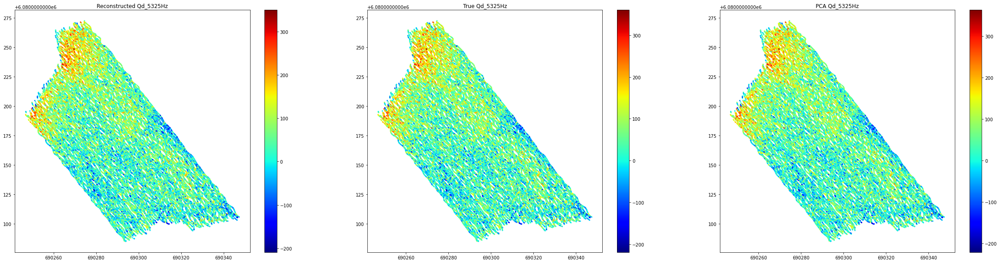

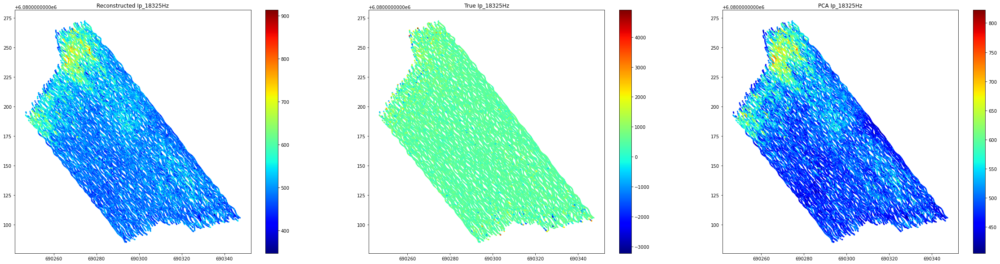

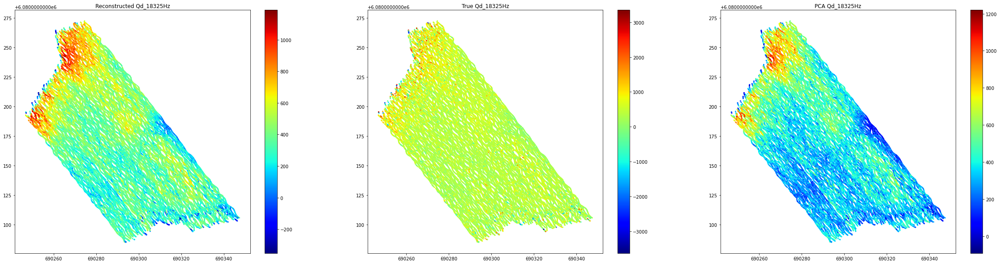

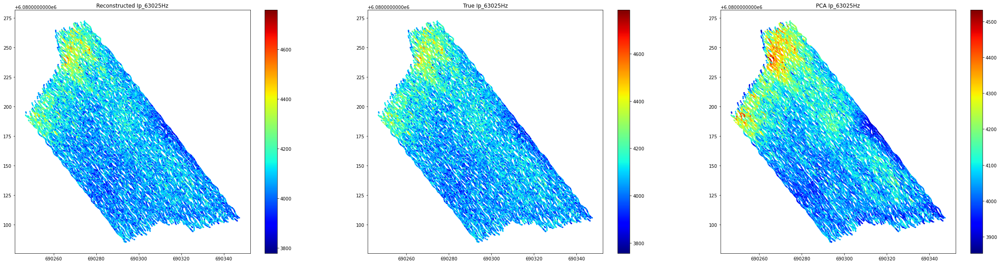

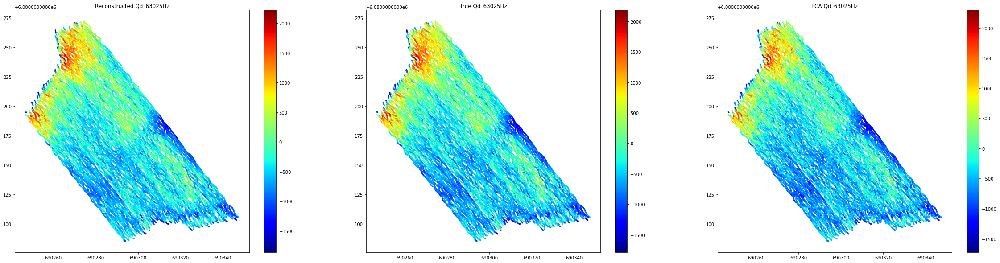

In [11]:
for i in range(13):
    plt.figure(figsize=(40,10))
    plt.subplot(1,3,1)
    plt.title(f'Reconstructed {data.test.columns[i]}')
    cm = plt.scatter(data.org_train.X,data.org_train.Y,c=recionstructed_data[:,i],cmap='jet',s=4)
    plt.colorbar()

    plt.subplot(1,3,2)
    plt.title(f'True {data.test.columns[i]}')
    cm = plt.scatter(data.org_train.X,data.org_train.Y,c=input_data[:,i],cmap='jet',s=4)
    plt.colorbar()

    plt.subplot(1,3,3)
    plt.title(f'PCA {data.test.columns[i]}')
    cm = plt.scatter(data.org_train.X,data.org_train.Y,c=train_pcs[:,i],cmap='jet',s=4)
    plt.colorbar()
    plt.show()

In [12]:
recionstructed_data.shape

(44922, 13)

In [13]:
input_data.shape

(44922, 13)

In [14]:
train_pcs.shape

(44922, 13)

In [15]:
np.stack((input_data,train_pcs,recionstructed_data)).shape

(3, 44922, 13)

In [16]:
np.save('data_org_recon_pca.npy',np.stack((input_data,train_pcs,recionstructed_data)))

# Test

In [17]:
pcas = Pca()
pcas.load_data(data.norm_data.norm_train,data.norm_data.norm_test)
pcas.get_pca(pca_amount=8)
train_pcs = data.get_inv(pcas.pca_test_inv)
train_org = data.get_inv(data.norm_data.norm_test)

In [18]:
results = Reconstruction()
results.load_model(model)
results.get_reconstructions(data.norm_data.norm_test)

recionstructed_data = data.get_inv(results.reconstructions)
input_data  = data.get_inv(data.norm_data.norm_test)
latent_space = results.latent_space

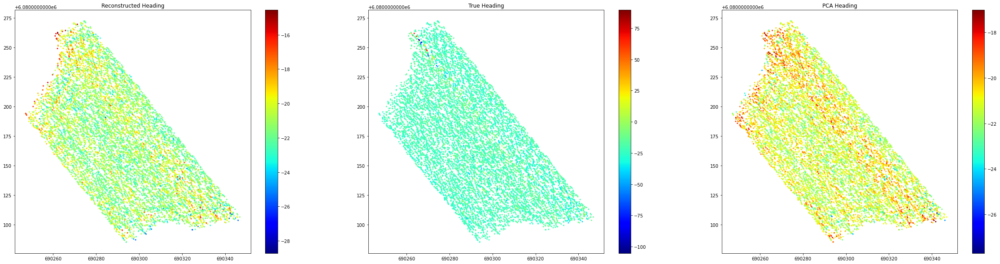

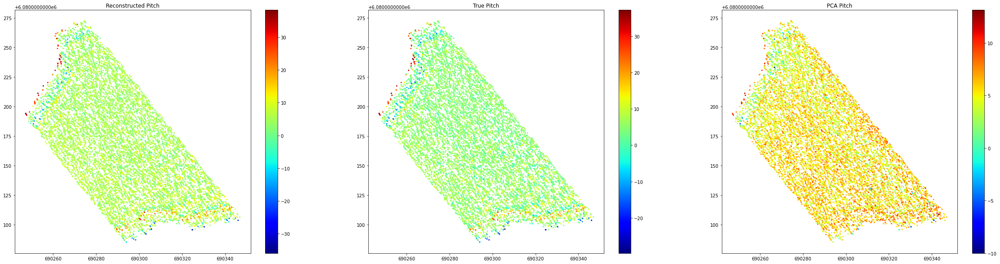

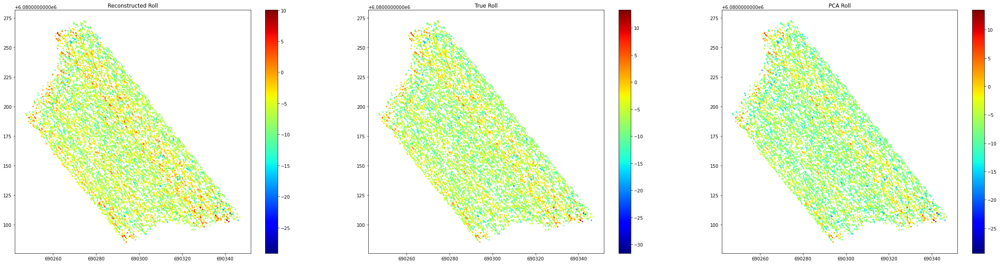

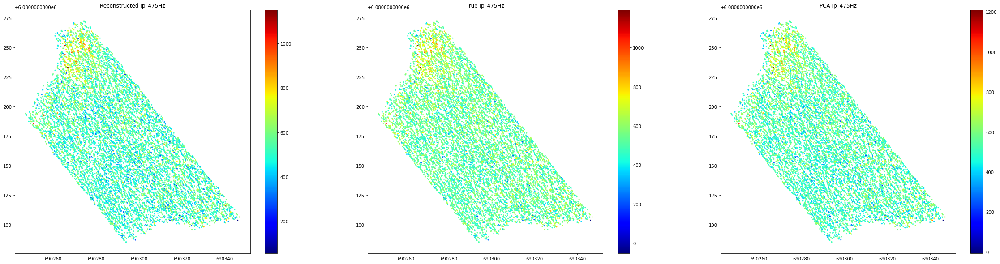

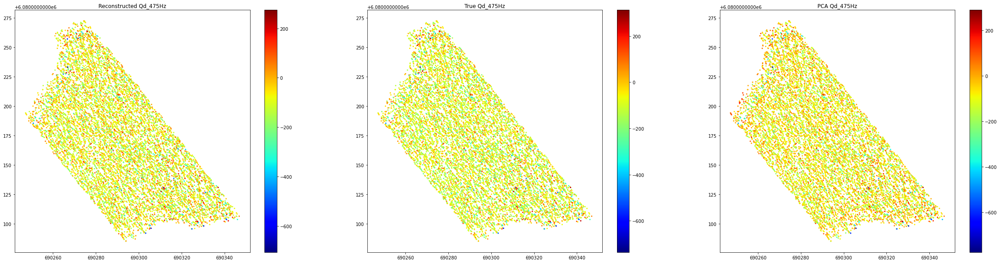

...

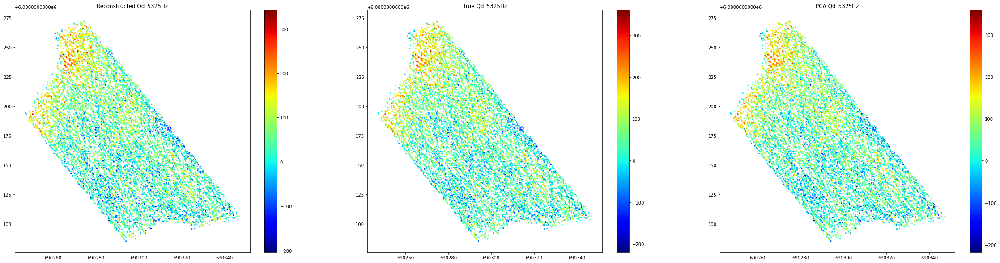

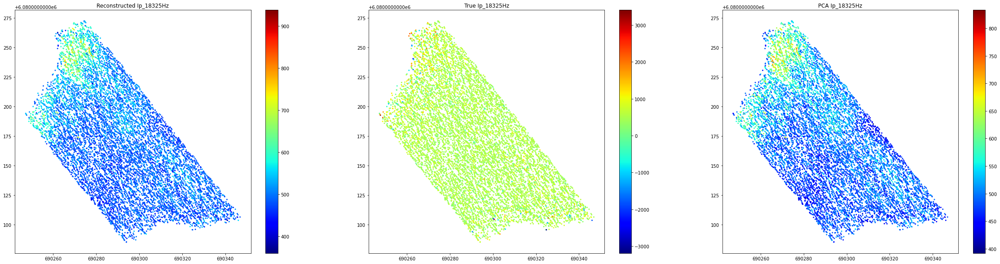

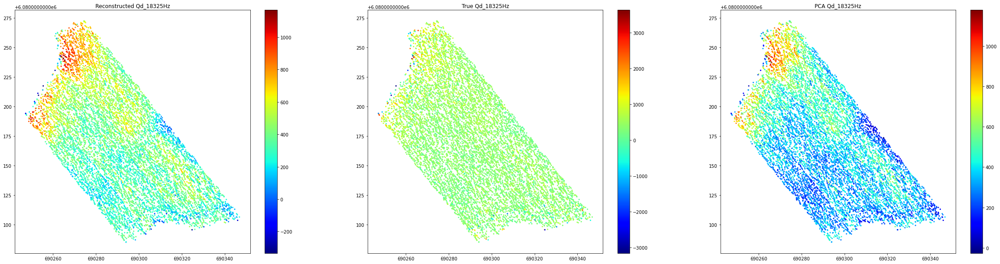

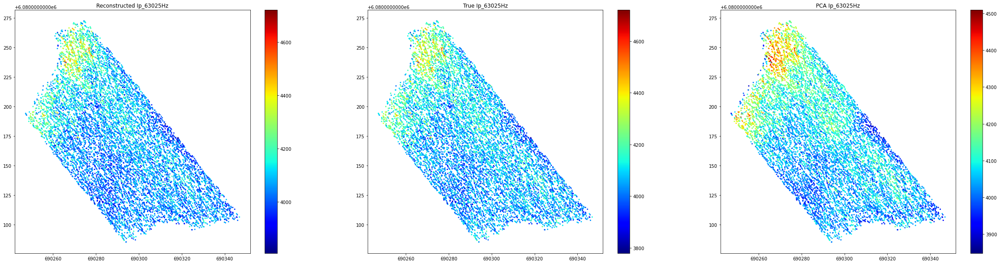

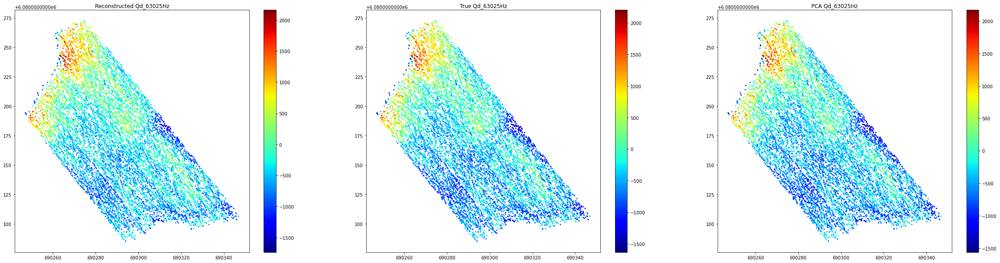

In [20]:
for i in range(13):
    plt.figure(figsize=(40,10))
    plt.subplot(1,3,1)
    plt.title(f'Reconstructed {data.test.columns[i]}')
    cm = plt.scatter(data.org_test.X,data.org_test.Y,c=recionstructed_data[:,i],cmap='jet',s=4)
    plt.colorbar()

    plt.subplot(1,3,2)
    plt.title(f'True {data.test.columns[i]}')
    cm = plt.scatter(data.org_test.X,data.org_test.Y,c=input_data[:,i],cmap='jet',s=4)
    plt.colorbar()

    plt.subplot(1,3,3)
    plt.title(f'PCA {data.test.columns[i]}')
    cm = plt.scatter(data.org_test.X,data.org_test.Y,c=train_pcs[:,i],cmap='jet',s=4)
    plt.colorbar()
    plt.show()

In [ ]:
np.save('test_data_org_recon_pca.npy',np.stack((input_data,train_pcs,recionstructed_data)))